In [1]:
import snowflake.connector
import os

conn = snowflake.connector.connect(
    user=os.environ['SNOWFLAKE_USER'],
    role=os.environ['SNOWFLAKE_ROLE'],
    password=os.environ['SNOWFLAKE_PASSWORD'],
    account=os.environ['SNOWFLAKE_ACCOUNT'],
    warehouse=os.environ['SNOWFLAKE_WAREHOUSE'],
    database=os.environ['SNOWFLAKE_DATABASE'],
    schema=os.environ['SNOWFLAKE_SCHEMA'],
    client_session_keep_alive=True
)



In [37]:
conn.close()

In [3]:
# %conda install "snowflake-connector-python[pandas]"


In [2]:
# Create a cursor object.
import pandas as pd
def run_sql(sql: str, ctx=conn):
    return conn.cursor().execute(sql)

import functools
import time

@functools.cache
def sql_to_df(sql_query, pre_hook=[], ctx=conn):
    print(f"RUNNING pre-hook: {pre_hook}")
    for s in pre_hook:
        run_sql(s,conn)
        # print(f"RUNNING SQL: {sql_query}")

    # todo: move to latest method of pandas dataframe fetching
    # may need to upgrade python: https://github.com/snowflakedb/snowflake-connector-python/issues/986#issuecomment-1115354587
    
    trimmed_lowered = sql_query.strip().lower()
    if trimmed_lowered.startswith('select') or trimmed_lowered.startswith('with'):
        print(f"using arrow to fetch results...")
        cur = ctx.cursor()
        cur.execute(sql_query)
        data = cur.fetch_pandas_all() 
        cur.close()
    else:
        data = pd.read_sql(
            sql_query,
            ctx,
        )
    
    data.columns = data.columns.str.lower()
    return data

In [5]:
%%markdown
# Idle Time 
We compute: 
- idle time for warehouse 
- some ballpark/conservative estimates for savings based on 20% idle time reduction

# Idle Time 
We compute: 
- idle time for warehouse 
- some ballpark/conservative estimates for savings based on 20% idle time reduction


RUNNING pre-hook: []
using arrow to fetch results...


,auto_suspend,warehouse_id,warehouse_name,warehouse_sizes,max_cluster_number,active_hours,idle_hours,pct_idle,dollars_used_compute,dollars_used_single_cluster_inferred,dollars_used_addtl_clusters_inferred,dollars_used_idle,dollars_used_active,cost_savings_estimate,cost_savings_estimate_annualized,cost_savings_estimate_pct
132,NaN,119,MEMBER_PROFILE_DE_WH_XL,"[\n ""X-Large""\n]",1,0.016947,0.016872,99.555811,0.54560,0.536888,0.000000,0.543177,0.002423,0.108635,1.303624,19.911162
133,NaN,185,FOUNDATION_2_WH,"[\n ""Medium""\n]",1,0.091594,0.033737,36.833566,0.72820,0.725428,0.000000,0.268222,0.459978,0.053644,0.643733,7.366713
129,NaN,136,DATA_STABILITY_WH,"[\n ""Small""\n]",1,0.187250,0.166100,88.704923,0.74580,0.741509,0.000000,0.661561,0.084239,0.132312,1.587747,17.740985
130,NaN,222,ENRICH_SCIENCE_ENGG_FORECAST_1_WH,"[\n ""Medium""\n]",1,0.103267,0.076444,74.025317,0.82280,0.817876,0.000000,0.609080,0.213720,0.121816,1.461793,14.805063
128,NaN,125,MESSAGE_GEAR_INSERT_WH,"[\n ""Small""\n]",1,0.425498,0.365836,85.978253,1.69070,1.684971,0.000000,1.453634,0.237066,0.290727,3.488722,17.195651
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4,NaN,123,MESSAGE_GEAR_WH,"[\n ""Medium""\n]",5,1069.472669,471.585452,44.095138,15738.81540,8470.223535,7268.591865,3734.956779,12003.858621,746.991356,8963.896271,4.746173
20,NaN,144,CAMPAIGN_ADMIN_1_WH,"[\n ""Medium""\n]",5,1447.067463,176.310999,12.184021,19284.34640,11460.774310,7823.572090,1396.383109,17887.963291,279.276622,3351.319462,1.448204
0,NaN,24,PLATFORM_DE_WH,"[\n ""Large"",\n ""Medium""\n]",2,1312.540346,524.404774,39.953421,21013.95945,20077.566821,936.392629,8021.674866,12992.284584,1604.334973,19252.019678,7.634615
16,NaN,61,SALES_BU_WH,"[\n ""Large""\n]",2,964.739529,98.437938,10.203577,24016.97705,15280.559039,8736.418011,1559.163562,22457.813488,311.832712,3741.992548,1.298385


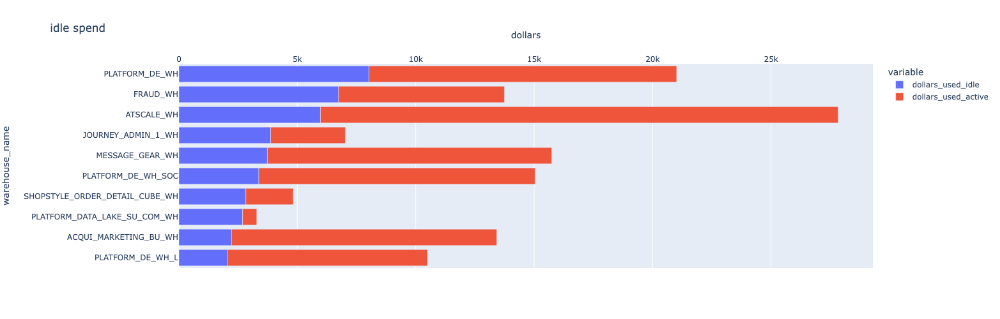

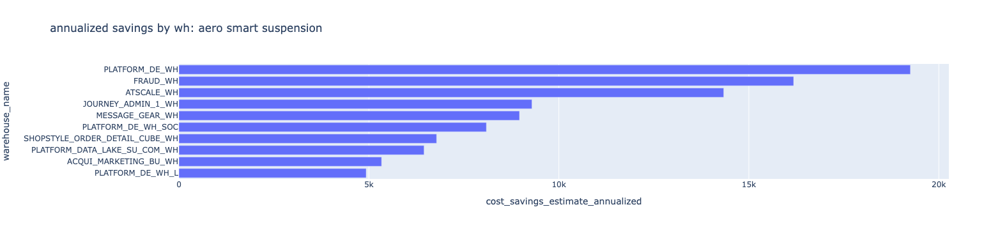

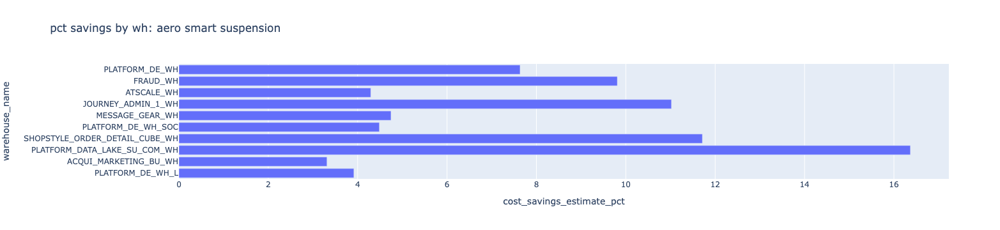

In [3]:
from IPython.display import display
import plotly.express as px

sql = """
with a as (

select 
    * exclude dollars_used_idle
from warehouse_profile
)
select
    *,
    case when max_cluster_number = 1 then 0 else dollars_used_compute - dollars_used_single_cluster_inferred end as dollars_used_addtl_clusters_inferred,
    (dollars_used_compute - dollars_used_addtl_clusters_inferred) *pct_idle/100 as dollars_used_idle,
    dollars_used_compute - dollars_used_idle as dollars_used_active,
    dollars_used_idle * 0.2 as cost_savings_estimate,
    12 * cost_savings_estimate as cost_savings_estimate_annualized,
    100* cost_savings_estimate / dollars_used_compute as cost_savings_estimate_pct
from a
order by dollars_used_idle desc;
"""
df = sql_to_df(sql)
display(df.sort_values('dollars_used_compute'))
fig = px.bar(
    df.sort_values('dollars_used_idle', ascending=True).tail(10), 
    y="warehouse_name", 
    x=["dollars_used_idle", 'dollars_used_active'], 
    # color = 'wh_utilization_status', 
    # color_discrete_sequence=['blue', 'green', 'red'],
    title = "idle spend",
    orientation='h',
    height=500
)

fig.update_layout(
    xaxis={'side': 'top'}, 
    xaxis_title="dollars"
)
fig.show()

fig = px.bar(
    df.sort_values('dollars_used_idle', ascending=True).tail(10), 
    y="warehouse_name", 
    x='cost_savings_estimate_annualized', 
    # color = 'wh_utilization_status', 
    # color_discrete_sequence=['blue', 'green', 'red'],
    title = "annualized savings by wh: aero smart suspension",
    orientation='h',
    height=100
)

fig.show()
# fig.update_layout(
#     xaxis={'side': 'top'}, 
#     xaxis_title="dollars"
# )
fig = px.bar(
    df.sort_values('dollars_used_idle', ascending=True).tail(10), 
    y="warehouse_name", 
    x='cost_savings_estimate_pct', 
    # color = 'wh_utilization_status', 
    # color_discrete_sequence=['blue', 'green', 'red'],
    title = "pct savings by wh: aero smart suspension",
    orientation='h',
    height=100
)
fig.show()

# fig.update_layout(
#     xaxis={'side': 'top'}, 
#     xaxis_title="dollars"
# )

# fig = px.bar(
#     df.sort_values('pct_idle', ascending=True), 
#     y="warehouse_name", 
#     x='pct_idle', 
#     # color = 'wh_utilization_status', 
#     # color_discrete_sequence=['blue', 'green', 'red'],
#     title = "pct_idle",
#     orientation='h',
#     height=2000
# )
# fig.show()

In [7]:
%%markdown
# Idle Time Deep Dive (WIP)

# Idle Time Deep Dive (WIP)


RUNNING pre-hook: []
using arrow to fetch results...


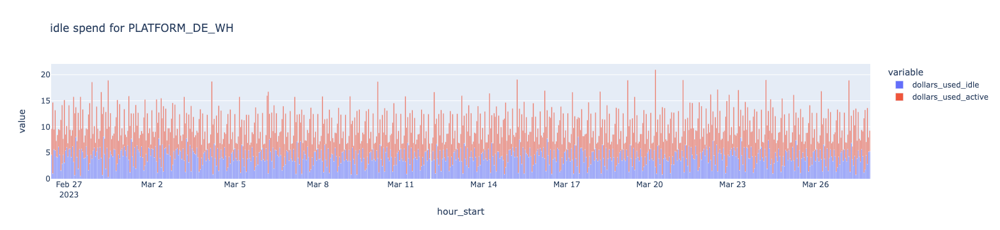

In [8]:
sql = """
select 
    * exclude dollars_used_idle, 
    case when max_cluster_number = 1 then 0 else dollars_used_compute - dollars_used_single_cluster_inferred end as dollars_used_addtl_clusters_inferred,
    (dollars_used_compute - dollars_used_addtl_clusters_inferred) *pct_idle/100 as dollars_used_idle,
    dollars_used_compute - dollars_used_idle as dollars_used_active,
    dollars_used_idle * 0.2 as cost_savings_estimate,
    div0(100* cost_savings_estimate, dollars_used_compute) as cost_savings_estimate_pct
from warehouse_profile_by_hour
order by cost_savings_estimate desc;
"""
df = sql_to_df(sql)
df = df[df.warehouse_name == 'PLATFORM_DE_WH']

fig = px.bar(
    df, 
    x="hour_start", 
    y=["dollars_used_idle", 'dollars_used_active'], 
    # color = 'wh_utilization_status', 
    # color_discrete_sequence=['blue', 'green', 'red'],
    title = "idle spend for PLATFORM_DE_WH",
    # orientation='h',
    # height=100
)
fig.show()

In [9]:
%%markdown
## --> some warehouses have significant idle time. This could be cut with more aggressive shutdowns and/or packing workloads onto fewer warehouses.

## --> some warehouses have significant idle time. This could be cut with more aggressive shutdowns and/or packing workloads onto fewer warehouses.


In [10]:
%%markdown
# Warehouse Resource Utilization
### Search for warehouses with queries that could be run on a smaller warehouse
### This would motivate resizing the warehouse or moving those queries to a smaller warehouse.

# Warehouse Resource Utilization
### Search for warehouses with queries that could be run on a smaller warehouse
### This would motivate resizing the warehouse or moving those queries to a smaller warehouse.


RUNNING pre-hook: []
using arrow to fetch results...


['MESSAGE_GEAR_WH',
 'PLATFORM_DE_WH',
 'PLATFORM_DATA_LAKE_SU_JP_WH',
 'PLATFORM_DATA_LAKE_SU_CA_WH',
 'ATSCALE_WH',
 'FRAUD_WH',
 'SHOPSTYLE_ORDER_DETAIL_CUBE_WH',
 'PLATFORM_DE_WH_SOC',
 'JOURNEY_ADMIN_1_WH',
 'EBATES_COM_REALTIME_DE_WH',
 'ACQUI_MARKETING_BI_WH',
 'CAMPAIGN_ADMIN_1_WH',
 'SECOPS_WH',
 'PLATFORM_DATA_LAKE_SU_COM_WH',
 'SINGULAR_WH',
 'PRODUCT_BI_WH',
 'PLATFORM_DE_WH_L',
 'RAKUTEN_BU_WH',
 'CANADA_BU_WH',
 'CAMPAIGN_3_WH',
 'PLATFORM_DE_WH_XL',
 'KLOUDIO_WH',
 'FRAUD_2_WH',
 'FRAUD_BU_WH',
 'SHOPSTYLE_ATSCALE_CUBE_WH1',
 'JAPAN_BU_WH',
 'BI_REVENUE_PLAN_WH',
 'SHOPSTYLE_DE_WH_1',
 'SHOPSTYLE_COLLECTIVE_DE_WH_1',
 'DATADOG_WH',
 'ACQUI_MARKETING_BU_WH',
 'FRAUD_1_WH',
 'ENRICH_ANALYTICS_ADMIN_1_WH',
 'SEGMENT_INGEST',
 'FOUNDATION_ADMIN_1_WH',
 'MARKETING_FLOW_SU_1_WH',
 'ENRICH_PLATFORM_SU_1_WH',
 'LIFECYCLE_1_WH',
 'MEMBER_PROFILE_DE_WH',
 'PRODUCT_BU_WH',
 'EMPOWERMENT_SU_1_WH',
 'MEMBER_PROFILE_DE_WH_L',
 'SALES_BU_WH',
 'FRAUD_ADMIN_1_WH',
 'FINANCE_BU_WH',
 'LI

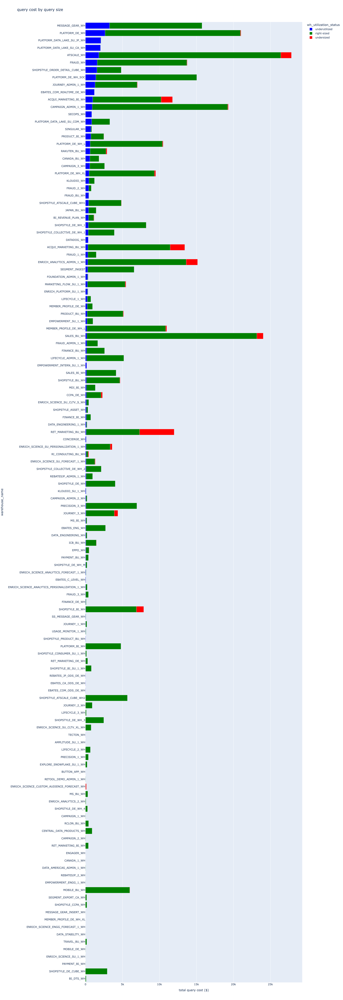

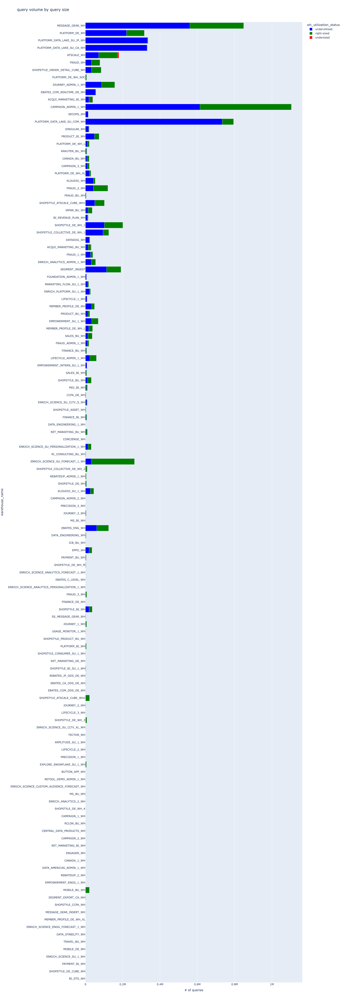

/var/folders/_8/8l7g_4kn4rb7glybx2qt73440000gn/T/ipykernel_50857/2271274502.py:85: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



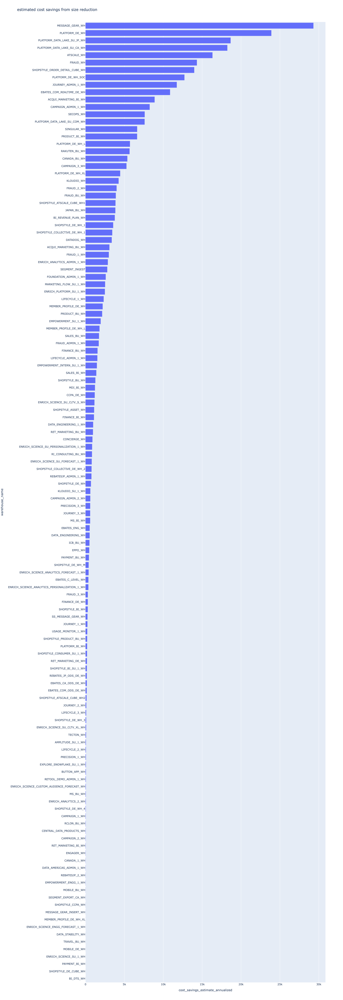

/var/folders/_8/8l7g_4kn4rb7glybx2qt73440000gn/T/ipykernel_50857/2271274502.py:98: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



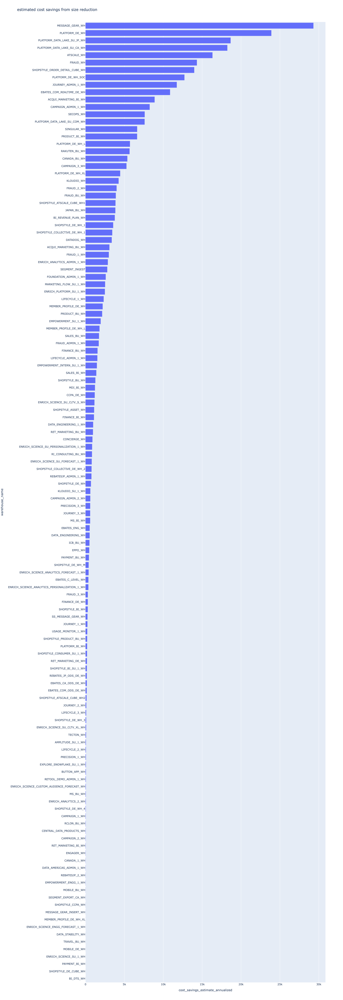

In [4]:
from IPython.display import display

sql = """
with a as (
select
    warehouse_name,
    case 
        when data_spilled_to_remote_storage_gb > 0 then 'undersized'
        when (execution_time_s < 10 and percentage_scanned_from_cache < 0.9) then 'underutilized'
        else 'right-sized'
    end as wh_utilization_status,
    
    --wh_utilization_status,
    (case when wh_utilization_status = 'underutilized' then 0 
when wh_utilization_status = 'right-sized' then 1 
else 2 end) as status_id,
    count(*) cnt,
    sum(query_cost) total_query_cost
from query_history_enriched
where ran_on_warehouse
group by 
    warehouse_name,
    wh_utilization_status
),
savings as (
select 
    *,
    first_value(total_query_cost) over (partition by warehouse_name order by status_id) as underutilized_cost,
    sum(total_query_cost) over (partition by warehouse_name) as total_cost,
    case when status_id = 0 then 0.75 * underutilized_cost end as cost_savings_estimate,
    cost_savings_estimate * 12 as cost_savings_estimate_annualized
from a
)
select *
from savings
order by underutilized_cost asc, warehouse_name, status_id
"""

df = sql_to_df(sql)

topten = df[df.status_id == 0].sort_values('total_query_cost', ascending=False).warehouse_name.tolist()
# topten = [
# 'MESSAGE_GEAR_WH',
#  'PLATFORM_DE_WH',
#  'ATSCALE_WH',
# ]
display(topten)
# display(df)
height = len(topten)*35
fig = px.bar(
    df[df.warehouse_name.isin(topten)], 
    y="warehouse_name", 
    x="total_query_cost", 
    color = 'wh_utilization_status', 
    color_discrete_sequence=['blue', 'green', 'red'],
    title = "query cost by query size",
    orientation='h',
    height=height
)
fig.update_layout(
    xaxis_title="total query cost ($)"
)

fig.show()


fig = px.bar(
    df[df.warehouse_name.isin(topten)], 
    y="warehouse_name", 
    x="cnt", 
    color = 'wh_utilization_status', 
    color_discrete_sequence=['blue', 'green', 'red'],
    title = "query volume by query size",
    orientation='h',
    height=height
)

fig.update_layout(
    xaxis_title="# of queries"
)
fig.show()


fig = px.bar(
    df[df.warehouse_name.isin(topten)][df.status_id == 0], 
    y="warehouse_name", 
    x="cost_savings_estimate_annualized", 
    # color = 'wh_utilization_status', 
    # color_discrete_sequence=['blue', 'green', 'red'],
    title = "estimated cost savings from size reduction",
    orientation='h',
    height=height
)
fig.show()


fig = px.bar(
    df[df.warehouse_name.isin(topten)][df.status_id == 0], 
    y="warehouse_name", 
    x="cost_savings_estimate_annualized", 
    # color = 'wh_utilization_status', 
    # color_discrete_sequence=['blue', 'green', 'red'],
    title = "estimated cost savings from size reduction",
    orientation='h',
    height=height
)
fig.show()


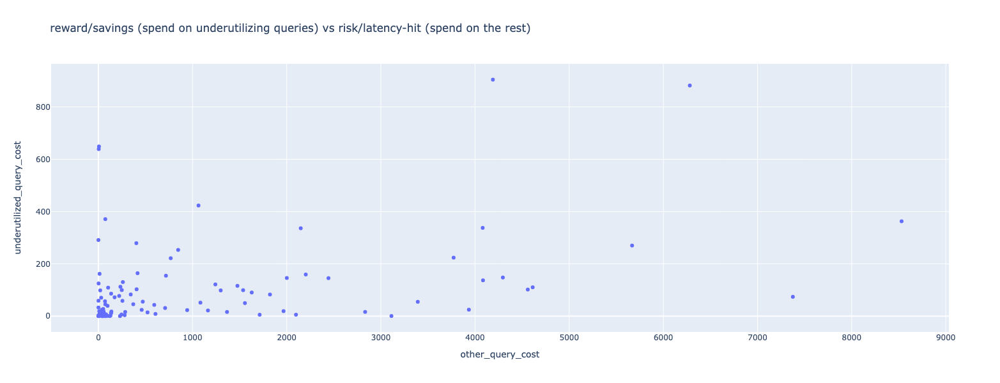

In [4]:
import plotly.express as px

sql = """
with a as (
select
    warehouse_name,
    wh_utilization_status,
    (case when wh_utilization_status = 'underutilized' then 0 
when wh_utilization_status = 'right-sized' then 1 
else 2 end) as status_id,
    count(*) cnt,
    sum(query_cost) total_query_cost
from query_history_narrowed
group by 
    warehouse_name,
    wh_utilization_status
)
select 
    warehouse_name,
    max(case when status_id = 0 then total_query_cost end) as underutilized_query_cost,
    sum(case when status_id != 0 then total_query_cost end) as other_query_cost
from a
group by 1
order by 2 desc nulls last;
"""

df = sql_to_df(sql)

fig = px.scatter(
    df, 
    x="other_query_cost", 
    y='underutilized_query_cost', 
    # color = 'wh_utilization_status', 
    # color_discrete_sequence=['blue', 'green', 'red'],
    title = "reward/savings (spend on underutilizing queries) vs risk/latency-hit (spend on the rest)",
    hover_data=['warehouse_name'],
    # orientation='h',
    height=600
)
fig.show()

In [ ]:
%%markdown
## Warehouses to the top and left are low hanging fruit; reduce their size ASAP. 
## Warheouses at the top and further right would also benefit from size reduction, but costreduction will come with a latency hit!

In [7]:
wh = 'ATSCALE_WH'
sql = f"""
select
    warehouse_name,
    query_load_percent,
    data_scanned_gb,
    data_spilled_to_local_storage_gb,
    data_spilled_to_remote_storage_gb,
    percentage_scanned_from_cache,
    percentage_scanned_from_cache > 0.9 as cache_hit,
    queued_overload_time_s,
    execution_time_s,
    wh_utilization_status
from query_history_narrowed
where warehouse_name = '{wh}'
"""

df = sql_to_df(sql)


RUNNING pre-hook: []
using arrow to fetch results...


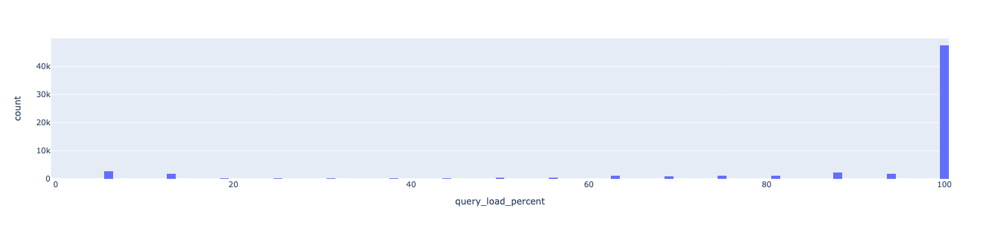

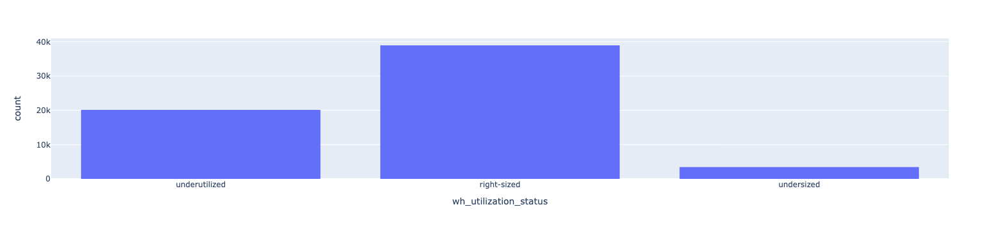

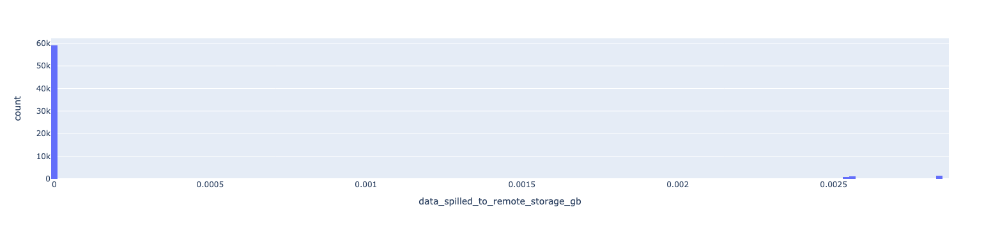

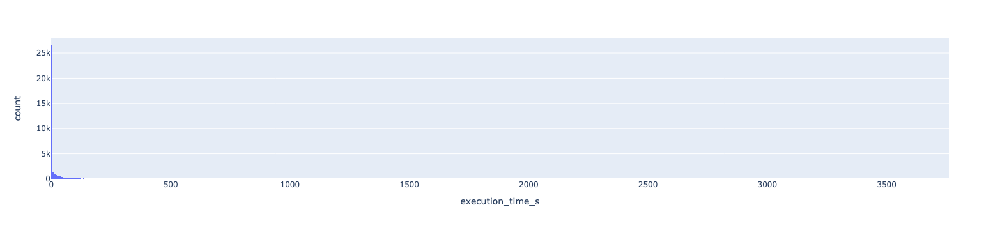

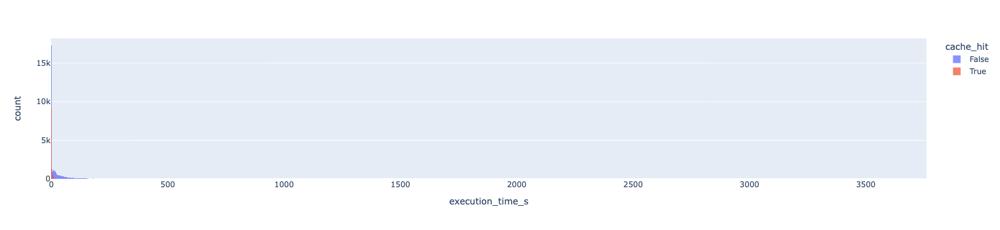

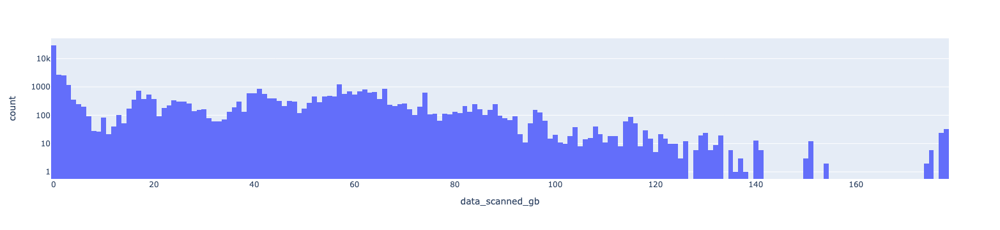

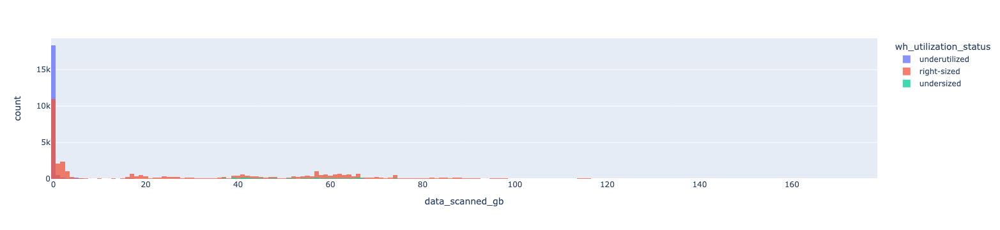

In [8]:
fig = px.histogram(df, x='query_load_percent')
fig.show()

fig = px.histogram(df, x='wh_utilization_status')
fig.show()

fig = px.histogram(df, x='data_spilled_to_remote_storage_gb')
fig.show()

fig = px.histogram(df, x='execution_time_s')
fig.show()

fig = px.histogram(df, x='execution_time_s', color='cache_hit')
fig.update_layout(barmode='overlay')
# Reduce opacity to see both histograms
fig.update_traces(opacity=0.75)
fig.show()

fig = px.histogram(df, x='data_scanned_gb', log_y=True)
fig.show()

fig = px.histogram(df, x='data_scanned_gb', color='wh_utilization_status')
fig.update_layout(barmode='overlay')
# Reduce opacity to see both histograms
fig.update_traces(opacity=0.75)
fig.show()

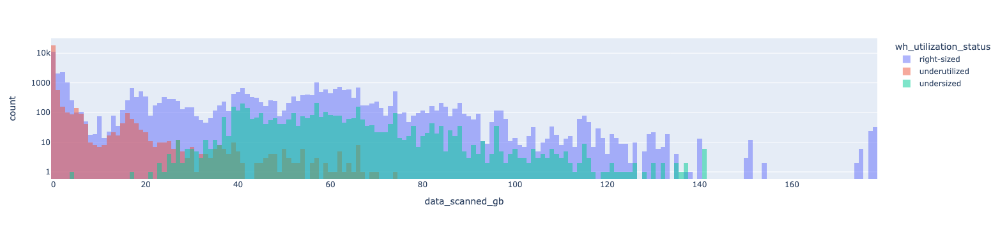

In [31]:

fig = px.histogram(df, x='data_scanned_gb', color='wh_utilization_status', log_y=True)
fig.update_layout(barmode='overlay')
# Reduce opacity to see both histograms
fig.update_traces(opacity=0.5)
fig.show()

In [ ]:
fig = px.density_heatmap(df, x="data_scanned_gb", y="execution_time_s", nbinsx=1000, nbinsy=1000)
fig.show()

In [ ]:
fig = px.histogram(df, x='execution_time_s', log_x=True)
fig.show()

In [ ]:
df.columns

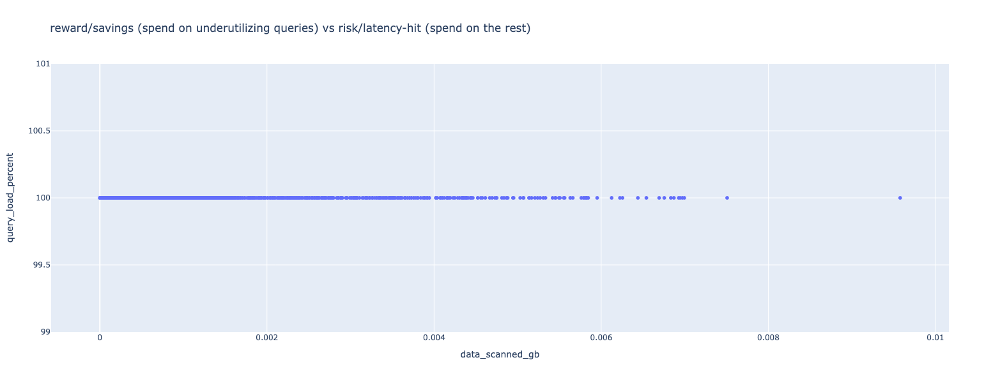

In [28]:
fig = px.scatter(
    df, 
    x="data_scanned_gb", 
    y='query_load_percent', 
    # color = 'wh_utilization_status', 
    # color_discrete_sequence=['blue', 'green', 'red'],
    title = "reward/savings (spend on underutilizing queries) vs risk/latency-hit (spend on the rest)",
    hover_data=['warehouse_name'],
    # orientation='h',
    height=600
)
fig.show()

In [ ]:
df.head(10)

In [ ]:
%%markdown
# SCRATCH
---------

In [ ]:
sql = """
with underutilizing_query_cost as (
    select
        warehouse_id,
        warehouse_name,
        -- wh_utilization_status,
        count(*) cnt,
        sum(query_cost) total_query_cost
    from query_history_narrowed
    where wh_utilization_status = 'underutilized'
    group by 
        warehouse_id, warehouse_name
),
idle_cost as (
    select 
        * exclude credits_used_idle, 
        case when max_cluster_number = 1 then 0 else credits_used_compute - credits_used_inferred end as credits_used_addtl_clusters,
        (credits_used_compute - credits_used_addtl_clusters) *pct_idle/100 as credits_used_idle,
        credits_used_compute - credits_used_idle as credits_used_active
    from warehouse_profile
    -- order by credits_used_idle desc
),
wh_load as (
    select 
        warehouse_id,
        warehouse_name,
        avg(avg_running) avg_running,
        avg(avg_queued_load) avg_queued_load,
        median(avg_queued_load) median_queued_load
    from 
        stg_warehouse_load_history
    where start_time > (select min(start_time) from query_history_narrowed)
    group by 1,2
)
select 
    i.*,
    w.avg_running,
    w.avg_queued_load,
    median_queued_load,
    coalesce(u.cnt, 0) as cnt,
    coalesce(u.total_query_cost, 0) as underutilized_query_spend,
    
    credits_used_idle + underutilized_query_spend as estimated_waste_total,
    credits_used_idle*0.2 + underutilized_query_spend*0.5 as estimated_cost_savings,
    100*estimated_cost_savings/credits_used_compute as estimated_cost_savings_pct
from idle_cost i
full outer join underutilizing_query_cost  u
on i.warehouse_name = u.warehouse_name and i.warehouse_id = u.warehouse_id
left join wh_load w
on i.warehouse_name = w.warehouse_name and i.warehouse_id = w.warehouse_id
order by estimated_waste_total desc
;
"""

df = sql_to_df(sql, ['set lookback_days=30'])
df

In [ ]:
sql = """
with qhe as (
select 
    *    
from
    qhe_lookback
),
stats as (
select
    warehouse_name,
    date_trunc('day', execution_start_time) date,
    wh_utilization_status,
    count(*) cnt,
    sum(query_cost) total_query_cost
from qhe
group by 
    warehouse_name,date,
    wh_utilization_status
),
wh_utilization_by_date as (
select 
    *,
    100*ratio_to_report(cnt) over (partition by warehouse_name, date) as pct_cnt,
    100*ratio_to_report(total_query_cost) over (partition by warehouse_name, date) as pct_total_query_cost
from stats
)
select * from wh_utilization_by_date
order by warehouse_name, 
(case when wh_utilization_status = 'underutilized' then 0 
when wh_utilization_status = 'right-sized' then 1 
else 2 end) asc
"""
df = sql_to_df(sql, ['set lookback_days=30'])
import plotly.express as px

for wh in candidates:
    fig = px.area(
        df[df.warehouse_name == wh], 
        x="date", 
        y="total_query_cost", 
        color = 'wh_utilization_status', 
        color_discrete_sequence=['blue', 'green', 'red'],
        title = f"[{wh}] query cost x query complexity"
    )
    fig.update_layout(hovermode="x")
    fig.show()

    # fig = px.area(
    #     df[df.warehouse_name == wh], 
    #     x="date", 
    #     y="cnt", 
    #     color = 'wh_utilization_status', 
    #     color_discrete_sequence=['blue', 'green', 'red'],
    #     title = "query count"
    # )
    # fig.update_layout(hovermode="x")
    # fig.show()

In [ ]:

warehouses = df.warehouse_name.unique()
for wh in warehouses[0:10]:

    fig = px.area(
        df[df.warehouse_name == wh], 
        x="date", 
        y="pct_total_query_cost", 
        color = 'wh_utilization_status', 
        color_discrete_sequence=['blue', 'green', 'red'],
        title = "query cost distribution"
    )
    fig.update_layout(hovermode="x")
    fig.show()

    fig = px.area(
        df[df.warehouse_name == wh], 
        x="date", y="pct_cnt", 
        color = 'wh_utilization_status', 
        color_discrete_sequence=['blue', 'green', 'red'],
        title = "query volume distribution"
    )
    fig.update_layout(hovermode="x")

    fig.show()